In [1]:
# some exploratory data analysis
# extract trips around London from Toby's dataset

In [23]:
import pandas as pd
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings. filterwarnings("ignore")

## Load data set with OSM features

In [24]:
data_dir = "./data/indoor_outdoor"
graph_dir = "./graphs"
data_path = os.path.join(data_dir, "new_data_set_with_roads_distance_land.csv")
bins = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15']

data = pd.read_csv(data_path)
data.head()

,Unnamed: 0,Unnamed: 0.1,timestamp,pm1,pm2_5,pm10,temperature,humidity,bin0,bin1,...,file label,i/o,gps_dist,gps_dist_std,geometry,highway,distance,close_road_idx,landuse,close_land_idx
0,0,0,1518035457738,1.245806,1.590959,1.605238,24.700000,23.700000,0.635514,0.177570,...,6,0,0.000000,0.0,POINT (-3.1834331 55.9446894),footway,0.000023,1493.0,building,889.0
1,1,1,1518038866288,0.558534,0.773462,0.949025,24.100000,23.800001,0.617021,0.127660,...,6,0,0.000018,0.0,POINT (-3.1834157 55.94468670000001),footway,0.000018,1493.0,unknown,NaN
2,2,2,1518039131629,0.347164,0.445047,0.461267,24.300001,24.000000,0.718750,0.156250,...,6,0,0.000023,0.0,POINT (-3.1834382 55.94468979999999),footway,0.000024,1493.0,building,889.0
3,3,3,1518041088275,0.466050,0.630702,0.819997,22.700000,25.400000,0.700000,0.125000,...,6,0,0.000041,0.0,POINT (-3.1833971 55.9446894),footway,0.000019,1493.0,unknown,NaN
4,4,4,1518046406113,3.238715,5.534687,13.598838,26.000000,36.500000,0.433213,0.176895,...,6,0,0.000030,0.0,POINT (-3.1833737 55.94470870000001),footway,0.000035,1493.0,building,889.0


In [25]:
np.unique(data['i/o'].astype(str), return_counts=True)

(array(['0', '1', '2'], dtype=object), array([2141, 2219, 2411]))

In [26]:
np.unique(data['landuse'].astype(str), return_counts=True)

(array(['building', 'outland', 'residential', 'unknown'], dtype=object),
 array([2037, 1519,  239, 2976]))

In [27]:
np.unique(data['highway'].astype(str), return_counts=True)

(array(['footway', 'primary_secondary', 'residential', 'tertiary',
        'unclassified', 'unknown'], dtype=object),
 array([4461,  797,  342,  257,  825,   89]))

In [28]:
indoor = data[data['i/o'] == 0]

In [29]:
out = data[data['i/o'] == 2]

In [30]:
np.unique(indoor['landuse'].astype(str), return_counts=True)

(array(['building', 'outland', 'residential', 'unknown'], dtype=object),
 array([1555,    3,   74,  509]))

In [31]:
np.unique(indoor['highway'].astype(str), return_counts=True)

(array(['footway', 'primary_secondary', 'residential'], dtype=object),
 array([1949,   51,  141]))

In [32]:
np.unique(out['landuse'].astype(str), return_counts=True)

(array(['building', 'outland', 'residential', 'unknown'], dtype=object),
 array([ 112,  406,  165, 1728]))

In [33]:
np.unique(out['highway'].astype(str), return_counts=True)

(array(['footway', 'primary_secondary', 'residential', 'tertiary',
        'unclassified', 'unknown'], dtype=object),
 array([663, 746, 201, 257, 455,  89]))

In [34]:
indoor['distance'].mean()

3.203545107447862e-05

In [35]:
out['distance'].mean()

8.048482639869958e-05

In [36]:
data = data[data['i/o'] != 1]
data.loc[data['i/o'] ==0 , 'i/o_label'] = 'indoor'
data.loc[data['i/o'] ==2 , 'i/o_label'] = 'commuting'

In [37]:
data.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'timestamp', 'pm1', 'pm2_5', 'pm10',
       'temperature', 'humidity', 'bin0', 'bin1', 'bin2', 'bin3', 'bin4',
       'bin5', 'bin6', 'bin7', 'bin8', 'bin9', 'bin10', 'bin11', 'bin12',
       'bin13', 'bin14', 'bin15', 'gpsLongitude', 'gpsLatitude', 'gpsAccuracy',
       'file label', 'i/o', 'gps_dist', 'gps_dist_std', 'geometry', 'highway',
       'distance', 'close_road_idx', 'landuse', 'close_land_idx', 'i/o_label'],
      dtype='object')

<AxesSubplot:xlabel='gps_dist', ylabel='Density'>

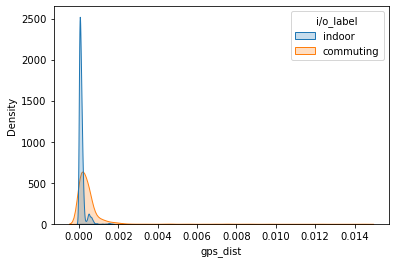

In [38]:
sns.kdeplot(data=data, x='gps_dist', hue='i/o_label', shade=True, palette="tab10")

<AxesSubplot:xlabel='gps_dist_std', ylabel='Density'>

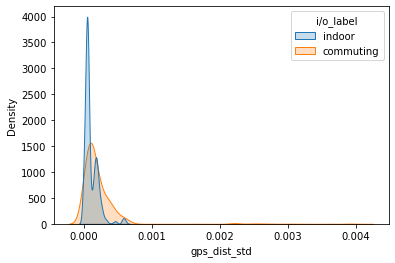

In [39]:
sns.kdeplot(data=data, x='gps_dist_std', hue='i/o_label', shade=True, palette="tab10")

<AxesSubplot:xlabel='distance', ylabel='Density'>

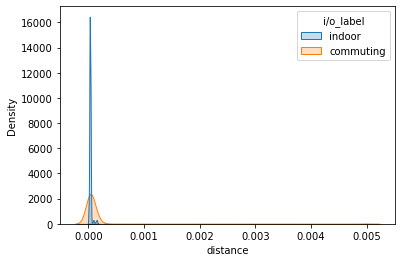

In [40]:
sns.kdeplot(data=data, x='distance', hue='i/o_label', shade=True, palette="tab10")

In [47]:
data.loc[data['i/o'] == 0, 'i/o'] = "indoor"
data.loc[data['i/o'] == 2, 'i/o'] = "commuting"

data.rename({'i,o':'micro-environment'},axis='columns')

,Unnamed: 0,Unnamed: 0.1,timestamp,pm1,pm2_5,pm10,temperature,humidity,bin0,bin1,...,i/o,gps_dist,gps_dist_std,geometry,highway,distance,close_road_idx,landuse,close_land_idx,i/o_label
0,0,0,1518035457738,1.245806,1.590959,1.605238,24.700000,23.700000,0.635514,0.177570,...,indoor,0.000000,0.000000,POINT (-3.1834331 55.9446894),footway,0.000023,1493.0,building,889.0,indoor
1,1,1,1518038866288,0.558534,0.773462,0.949025,24.100000,23.800001,0.617021,0.127660,...,indoor,0.000018,0.000000,POINT (-3.1834157 55.94468670000001),footway,0.000018,1493.0,unknown,NaN,indoor
2,2,2,1518039131629,0.347164,0.445047,0.461267,24.300001,24.000000,0.718750,0.156250,...,indoor,0.000023,0.000000,POINT (-3.1834382 55.94468979999999),footway,0.000024,1493.0,building,889.0,indoor
3,3,3,1518041088275,0.466050,0.630702,0.819997,22.700000,25.400000,0.700000,0.125000,...,indoor,0.000041,0.000000,POINT (-3.1833971 55.9446894),footway,0.000019,1493.0,unknown,NaN,indoor
4,4,4,1518046406113,3.238715,5.534687,13.598838,26.000000,36.500000,0.433213,0.176895,...,indoor,0.000030,0.000000,POINT (-3.1833737 55.94470870000001),footway,0.000035,1493.0,building,889.0,indoor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6766,6765,6765,1519761102243,3.075573,5.121366,5.931179,0.100000,61.600002,0.475177,0.141844,...,commuting,0.000409,0.000168,POINT (-3.1995004 55.9449343),tertiary,0.000081,22610.0,unknown,NaN,commuting
6767,6766,6766,1519761110027,3.777208,5.779887,6.561466,0.100000,61.600002,0.478788,0.187879,...,commuting,0.000278,0.000149,POINT (-3.1992446 55.9450427),unclassified,0.000079,313.0,unknown,NaN,commuting
6768,6767,6767,1519761117810,2.585976,4.300748,23.491010,0.100000,61.600002,0.444444,0.190476,...,commuting,0.000335,0.000154,POINT (-3.1989099 55.9450468),footway,0.000059,17141.0,unknown,NaN,commuting
6769,6768,6768,1519761125594,2.675924,4.470054,5.379007,0.100000,61.600002,0.437500,0.218750,...,commuting,0.000377,0.000132,POINT (-3.1985354 55.9450068),footway,0.000014,15780.0,unknown,NaN,commuting


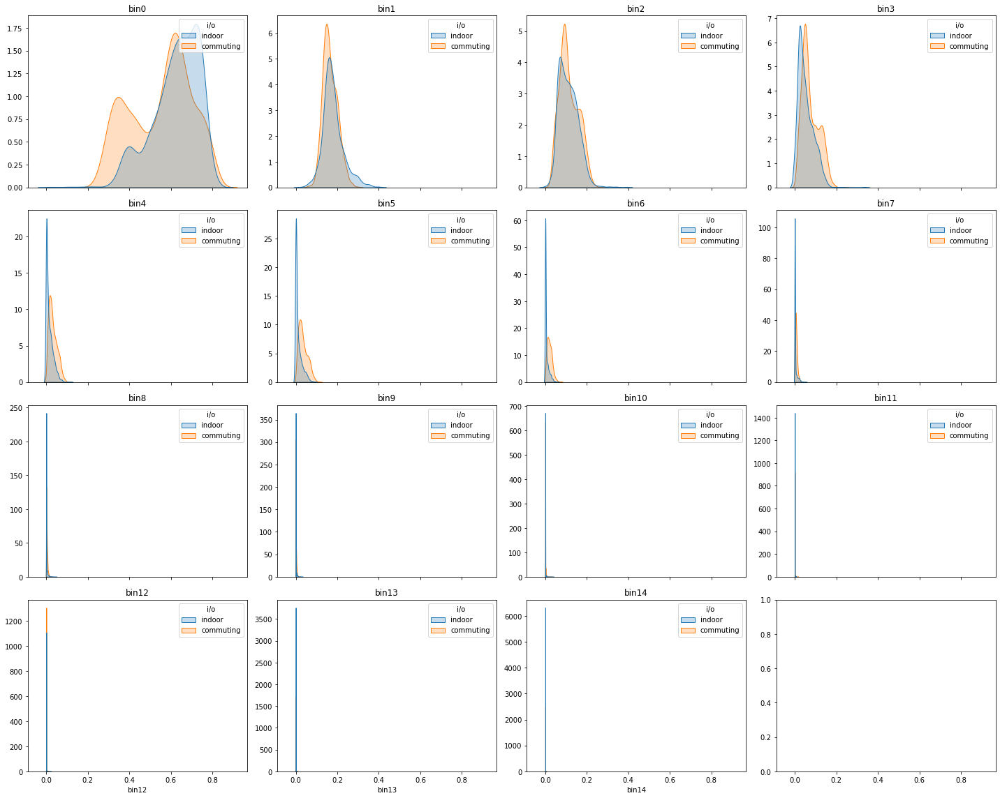

In [48]:
fig, axs = plt.subplots(4, 4, sharex=True, figsize=(20,16))

for i in range(15):
    sns.kdeplot(data=data, x=bins[i], hue='i/o', ax = axs[int(i/4),i%4], shade=True, palette="tab10")
    axs[int(i/4),i%4].set_ylabel("")
    axs[int(i/4),i%4].set_title("{}".format(bins[i]))
plt.tight_layout()
plt.savefig(os.path.join(graph_dir, 'bin_kde.pdf'))

## London unseen data

In [197]:
data_path = os.path.join(data_dir, "london_unseen_data_with_roads_distance_land.csv")
data_london = pd.read_csv(data_path)
data_london.head()

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,phoneTimestamp,pm1,pm2_5,pm10,temperature,humidity,bin0,...,file label,label,gps_dist,gps_dist_std,geometry,highway,distance,close_road_idx,landuse,close_land_idx
0,0,0,1,1615372515205,237.31105,370.23590,595.01416,24.1,32.600002,0.944070,...,0,2,0.000000,0.0,POINT (-0.1347332 51.5647706),unknown,0.000073,834.0,building,11340.0
1,0,0,1,1615372515205,237.31105,370.23590,595.01416,24.1,32.600002,0.944070,...,0,2,0.000000,0.0,POINT (-0.1347332 51.5647706),unknown,0.000073,834.0,building,51942.0
2,1,1,2,1615372546162,199.71940,362.13116,671.52466,24.1,33.600002,0.917814,...,0,2,0.000165,0.0,POINT (-0.1346755 51.5646165),residential,0.000139,39140.0,building,11351.0
3,1,1,2,1615372546162,199.71940,362.13116,671.52466,24.1,33.600002,0.917814,...,0,2,0.000165,0.0,POINT (-0.1346755 51.5646165),residential,0.000139,39140.0,building,51942.0
4,2,2,3,1615372580334,188.60129,346.55814,657.45220,24.2,33.600002,0.910040,...,0,2,0.000064,0.0,POINT (-0.1346846 51.56467960000001),unknown,0.000156,834.0,building,11332.0


In [203]:
data_london.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'Unnamed: 0.1.1', 'phoneTimestamp', 'pm1',
       'pm2_5', 'pm10', 'temperature', 'humidity', 'bin0', 'bin1', 'bin2',
       'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8', 'bin9', 'bin10',
       'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'total', 'gpsLongitude',
       'gpsLatitude', 'gpsAltitude', 'gpsAccuracy', 'luxLevel', 'motion',
       'battery', 'subjectID', 'location', 'activity', 'file label', 'label',
       'gps_dist', 'gps_dist_std', 'geometry', 'highway', 'distance',
       'close_road_idx', 'landuse', 'close_land_idx'],
      dtype='object')

In [199]:
np.unique(data_london['activity'].astype(str), return_counts=True)

(array(['Boiling', 'Candle burning', 'Frying', 'In the car',
        'On the train', 'On the tube', 'Riding a bike', 'Running',
        'Sitting', 'Walking'], dtype=object),
 array([ 88, 168,  37, 146,  36,  73,  75,  63, 576, 104]))

In [200]:
tube_data = data_london[data_london['activity'] == 'On the tube']

In [206]:
c = getCoords(tube_data, timestamp=True)
getMap(c, tube_data, classification=False)

## Load new data set from Teo

In [20]:
data_path = os.path.join(data_dir, "all_data_new.csv")
data_new = pd.read_csv(data_path)
data_new.head()

,phoneTimestamp,pm1,pm2_5,pm10,temperature,humidity,bin0,bin1,bin2,bin3,...,battery,subjectID,location,activity,location_type,activity_type,recording_id,timestamp,tubeline,notes
0,1619207735815,61.65100,234.59213,1067.6111,23.200000,41.3,8663.0,4326.0,1414.0,577.0,...,186.0,XXT012,Indoor,Frying,50,56,0,2021-04-23 19:55:35.815,N/a,N/a
1,1619207764852,70.75856,266.43765,1122.5253,23.300001,42.9,9543.0,5260.0,1510.0,643.0,...,121.0,XXT012,Indoor,Frying,50,56,0,2021-04-23 19:56:04.852,N/a,N/a
2,1619207793213,199.48593,794.64484,3405.0840,23.400000,46.2,24507.0,12169.0,3819.0,1713.0,...,83.0,XXT012,Indoor,Frying,50,56,0,2021-04-23 19:56:33.213,N/a,N/a
3,1619207822905,98.84125,344.06430,1336.6385,23.500000,44.2,12010.0,6369.0,1721.0,740.0,...,147.0,XXT012,Indoor,Frying,50,56,0,2021-04-23 19:57:02.905,N/a,N/a
4,1619207851915,124.58865,465.23312,2064.2168,23.700000,48.8,14781.0,8284.0,2382.0,968.0,...,220.0,XXT012,Indoor,Frying,50,56,0,2021-04-23 19:57:31.915,N/a,N/a


commuting: On the bus, In the car, On the train, On the tube, Riding a bike, Running, Walking(Outdoor)

In [21]:
data_new.loc[data_new['activity'] == 'On the bus', 'location'] = 'Commuting'
data_new.loc[data_new['activity'] == 'In the car', 'location'] = 'Commuting'
data_new.loc[data_new['activity'] == 'On the train', 'location'] = 'Commuting'
data_new.loc[data_new['activity'] == 'On the tube', 'location'] = 'Commuting'
data_new.loc[data_new['activity'] == 'Riding a bike', 'location'] = 'Commuting'
data_new.loc[data_new['activity'] == 'Running', 'location'] = 'Commuting'
data_new.loc[(data_new['activity'] == 'Walking')&(data_new['location'] == 'Outdoor'), 'location'] = 'Commuting'

In [22]:
data_new_commute = data_new[data_new['location'] == 'Commuting']
data_new_outdoor = data_new[data_new['location'] == 'Outdoor']
data_new_indoor = data_new[data_new['location'] == 'Indoor']

In [23]:
np.unique(data_new_commute['activity'], return_counts=True)

(array(['In the car', 'On the bus', 'On the train', 'On the tube',
        'Riding a bike', 'Running', 'Walking'], dtype=object),
 array([3051,  424,  119,  780,  926,  299, 1705]))

In [24]:
np.unique(data_new_outdoor['activity'], return_counts=True)

(array(['Frying', 'Sitting'], dtype=object), array([186, 239]))

In [25]:
np.unique(data_new_indoor['activity'], return_counts=True)

(array(['Boiling', 'Candle burning', 'Cleaning spray', 'Climbing stairs',
        'Deodorant spraying', 'Descending stairs', 'Frying', 'Hoovering',
        'Lying down', 'Sitting', 'Toasting', 'Walking'], dtype=object),
 array([ 184,  400,   18,    3,   14,    3,  935,   13,  625, 2742,   35,
          21]))

In [26]:
np.unique(data_new['location'], return_counts=True)

(array(['Commuting', 'Indoor', 'Outdoor'], dtype=object),
 array([7304, 4993,  425]))

In [27]:
data_new = data_new[data_new['location'] != 'Outdoor']

In [28]:
np.unique(data_new['location'], return_counts=True)

(array(['Commuting', 'Indoor'], dtype=object), array([7304, 4993]))

In [29]:
data_new.columns

Index(['phoneTimestamp', 'pm1', 'pm2_5', 'pm10', 'temperature', 'humidity',
       'bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'total',
       'gpsLongitude', 'gpsLatitude', 'gpsAltitude', 'gpsAccuracy', 'luxLevel',
       'motion', 'battery', 'subjectID', 'location', 'activity',
       'location_type', 'activity_type', 'recording_id', 'timestamp',
       'tubeline', 'notes'],
      dtype='object')

## Plot the data points in the map

In [30]:
data_new.tail()

,phoneTimestamp,pm1,pm2_5,pm10,temperature,humidity,bin0,bin1,bin2,bin3,...,battery,subjectID,location,activity,location_type,activity_type,recording_id,timestamp,tubeline,notes
12717,1619521962947,3.672200,11.107073,55.992077,25.6,42.000000,745.0,269.0,51.0,32.0,...,22.0,XXT012,Indoor,Toasting,50,59,192,2021-04-27 11:12:42.947,N/a,N/a
12718,1619521993917,3.891484,10.058439,39.499363,25.6,41.800000,643.0,337.0,63.0,22.0,...,233.0,XXT012,Indoor,Toasting,50,59,192,2021-04-27 11:13:13.917,N/a,N/a
12719,1619522024873,3.565497,10.378777,46.101750,25.6,41.600002,665.0,266.0,61.0,22.0,...,165.0,XXT012,Indoor,Toasting,50,59,192,2021-04-27 11:13:44.873,N/a,N/a
12720,1619522056476,3.823732,11.218196,35.460260,25.6,41.800000,724.0,292.0,74.0,28.0,...,218.0,XXT012,Indoor,Toasting,50,59,192,2021-04-27 11:14:16.476,N/a,N/a
12721,1619522088090,4.113671,10.587336,30.470325,25.6,42.200000,802.0,318.0,79.0,27.0,...,65.0,XXT012,Indoor,Toasting,50,59,192,2021-04-27 11:14:48.090,N/a,N/a


In [31]:
# Code from mapping notebook (could put this in a .py file)
from geopy import distance
import folium

def getCoords(df, timestamp=False):
    # return list of lists, each inside list contains the coordinate of one data point
    coords = df.filter(['gpsLatitude', 'gpsLongitude'])
    coords = list(coords.to_records(index=timestamp))
    return [list(c) for c in coords]

def getMap(coords, df, transport=False, classification=False, line=False):
    # draw the map, if classification=True, draw different class with different colors
    # Maps © www.thunderforest.com, Data © www.osm.org/copyright
    m = folium.Map(location=coords[0][1:3], zoom_start=12)
    if transport:
        m = folium.Map(location=coords[0][1:3], zoom_start=12, tiles = 'https://tile.thunderforest.com/transport/{z}/{x}/{y}.png?apikey=79284124c2f24955b9cd0d84c306bd0d', attr= "Transport")
    cs = []
    colour = 'red'
    for i,c in enumerate(coords):
        if classification==True:
            io = df.iloc[i]['location']
            if io == 'Indoor':
                # Indoor
                colour = 'crimson'
            elif io == 'Outdoor':
                # Outdoor
                colour = 'green'
            elif io == 'Commuting':
                colour = 'darkblue'

            
        coord = c[1:3]
        cs.append(coord)
        
        label = "Coords: {0}".format(c)
        if classification== True:
            label += "\n Classification: {0}".format(io)
        
        folium.Circle(
            radius=10,
            location=coord,
            popup=label,
            color=colour,
            fill=True,
        ).add_to(m)
    
    if line==True:
        folium.PolyLine(cs).add_to(m)
    return m

In [32]:
data = data_new.sort_values('timestamp', axis=0, ascending=True, inplace=False)
data.columns

Index(['phoneTimestamp', 'pm1', 'pm2_5', 'pm10', 'temperature', 'humidity',
       'bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'total',
       'gpsLongitude', 'gpsLatitude', 'gpsAltitude', 'gpsAccuracy', 'luxLevel',
       'motion', 'battery', 'subjectID', 'location', 'activity',
       'location_type', 'activity_type', 'recording_id', 'timestamp',
       'tubeline', 'notes'],
      dtype='object')

In [67]:
np.unique(data[:1000]['location'], return_counts=True)

(array(['Commuting', 'Indoor'], dtype=object), array([389, 611]))

In [68]:
c = getCoords(data[:1000], timestamp=True)
getMap(c, data[:1000], classification=True)

In [72]:
np.unique(data[1800:3600]['location'], return_counts=True)

(array(['Commuting', 'Indoor'], dtype=object), array([1093,  707]))

In [73]:
c = getCoords(data[1800:3600], timestamp=True)
getMap(c, data[1800:3600], classification=True)

In [87]:
np.unique(data[6500:11000]['location'], return_counts=True)

(array(['Commuting', 'Indoor'], dtype=object), array([1713, 2787]))

In [101]:
c = getCoords(data[7500:11000], timestamp=True)
getMap(c, data[7500:11000], classification=True)

In [33]:
data_select = pd.concat([data[:1000], data[1800:3600], data[6500:11000]])
data_select.shape

(7300, 39)

In [34]:
data_select.head()

,phoneTimestamp,pm1,pm2_5,pm10,temperature,humidity,bin0,bin1,bin2,bin3,...,battery,subjectID,location,activity,location_type,activity_type,recording_id,timestamp,tubeline,notes
9076,1614763472266,31.357779,68.628010,168.52596,25.9,38.300000,7102.0,1098.0,248.0,90.0,...,227.0,XXT012,Indoor,Sitting,50,0,147,2021-03-03 09:24:32.266,N/a,N/a
9077,1614763506447,31.063381,68.659660,199.63565,25.9,39.000000,8090.0,996.0,264.0,109.0,...,179.0,XXT012,Indoor,Sitting,50,0,147,2021-03-03 09:25:06.447,N/a,N/a
9078,1614763537409,31.755910,68.593600,211.94217,26.7,37.200000,6981.0,1140.0,237.0,99.0,...,79.0,XXT012,Indoor,Sitting,50,0,147,2021-03-03 09:25:37.409,N/a,N/a
9079,1614763569653,31.561163,71.432800,229.19894,27.6,36.100002,7352.0,1043.0,243.0,100.0,...,43.0,XXT012,Indoor,Sitting,50,0,147,2021-03-03 09:26:09.653,N/a,N/a
9080,1614763599327,32.124138,66.662285,185.78313,28.2,34.900000,7345.0,977.0,239.0,102.0,...,137.0,XXT012,Indoor,Sitting,50,0,147,2021-03-03 09:26:39.327,N/a,N/a


In [35]:
np.unique(data_select['location'], return_counts=True)

(array(['Commuting', 'Indoor'], dtype=object), array([3195, 4105]))

In [96]:
c = getCoords(data_select, timestamp=True)
getMap(c, data_select, classification=True)

In [36]:
data_select.to_csv(os.path.join(data_dir,'all_data_new_select.csv'))

In [37]:
data_select.columns

Index(['phoneTimestamp', 'pm1', 'pm2_5', 'pm10', 'temperature', 'humidity',
       'bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'total',
       'gpsLongitude', 'gpsLatitude', 'gpsAltitude', 'gpsAccuracy', 'luxLevel',
       'motion', 'battery', 'subjectID', 'location', 'activity',
       'location_type', 'activity_type', 'recording_id', 'timestamp',
       'tubeline', 'notes'],
      dtype='object')